# Dentate gyrus dataset

This tutorial uses raw data from [scvelo](https://github.com/theislab/scvelo) package. Special thanks go to the scvelo team! 

In [1]:
# from IPython.core.display import display, HTML
# display(HTML("<style>.container { width:90% !important; }</style>"))
# %matplotlib inline

import warnings
warnings.filterwarnings('ignore')

import dynamo as dyn

dyn.get_all_dependencies_version()

package,dynamo-release,pre-commit,cvxopt,trimap,numdifftools,colorcet,python-igraph,pynndescent,hdbscan,loompy,matplotlib,networkx,numba,numpy,pandas,scikit-learn,scipy,seaborn,setuptools,statsmodels,tqdm,umap-learn
version,1.0.0,2.11.1,1.2.6,1.4.3.dev1,0.9.39,2.0.6,0.9.0,0.5.2,0.8.27,3.0.6,3.4.1,2.5.1,0.53.1,1.20.3,1.2.3,0.23.2,1.6.1,0.11.1,54.2.0,0.12.2,4.58.0,0.5.1


In [2]:
# emulate ggplot2 plotting styple with white background
dyn.configuration.set_figure_params('dynamo', background='white')  


In [3]:
adata = dyn.sample_data.DentateGyrus_scvelo()

adata.obsm['X_umap_ori'] = adata.obsm['X_umap'].copy()

|-----> Downloading data to ./data/dentategyrus_scv.h5ad


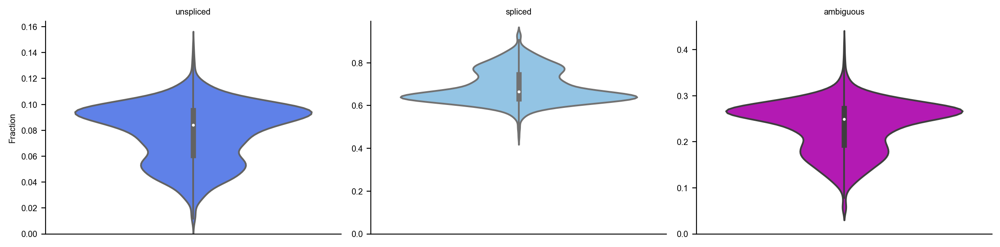

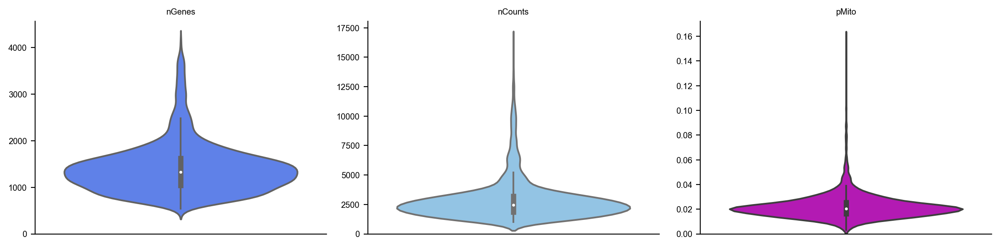

In [4]:
dyn.pl.show_fraction(adata)
dyn.pl.basic_stats(adata)


In [5]:
dyn.pp.recipe_monocle(adata, n_top_genes=2000, fg_kwargs={'shared_count': 30}, num_dim=30)


|-----> apply Monocole recipe to adata...
|-----> <insert> pp to uns in AnnData Object.
|-----------> <insert> has_splicing to uns['pp'] in AnnData Object.
|-----------> <insert> has_labling to uns['pp'] in AnnData Object.
|-----------> <insert> splicing_labeling to uns['pp'] in AnnData Object.
|-----------> <insert> has_protein to uns['pp'] in AnnData Object.
|-----> ensure all cell and variable names unique.
|-----> ensure all data in different layers in csr sparse matrix format.
|-----> ensure all labeling data properly collapased
|-----------> <insert> tkey to uns['pp'] in AnnData Object.
|-----------> <insert> experiment_type to uns['pp'] in AnnData Object.
|-----> filtering cells...
|-----> filtering genes...
|-----> calculating size factor...
|-----> selecting genes...
|-----> <insert> frac to var in AnnData Object.
|-----> size factor normalizing the data, followed by log1p transformation.
|-----> applying PCA ...
|-----> <insert> pca_fit to uns in AnnData Object.
|-----> <inse

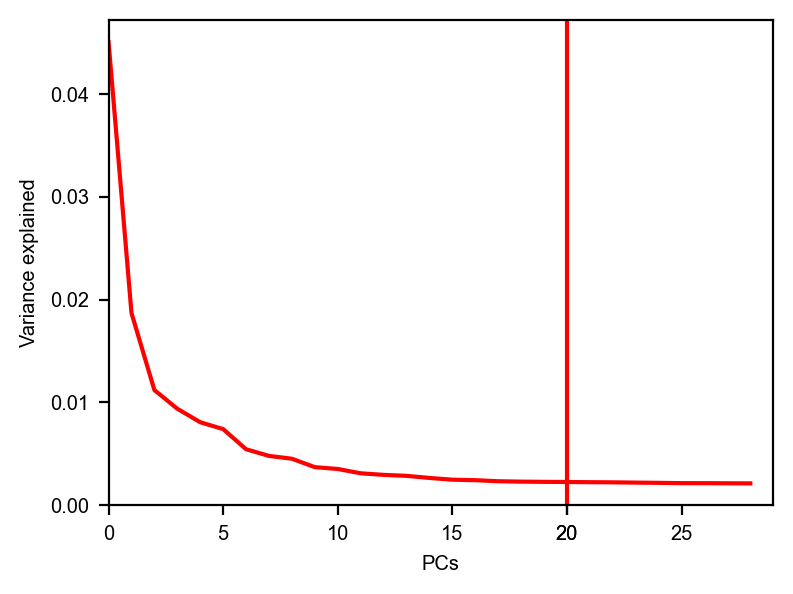

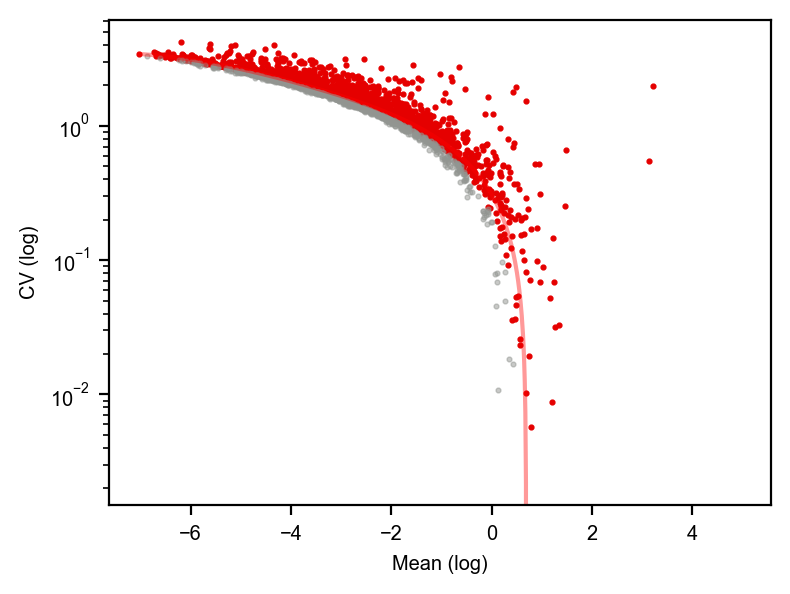

In [6]:
dyn.pl.variance_explained(adata)
dyn.pl.feature_genes(adata)

In [7]:
dyn.tl.dynamics(adata, model='stochastic', cores=3) 
# or dyn.tl.dynamics(adata, model='deterministic')
# or dyn.tl.dynamics(adata, model='stochastic', est_method='negbin')

|-----> calculating first/second moments...
|-----> [moments calculation] in progress: 100.0000%
|-----> [moments calculation] finished [30.9014s]


AnnData object with n_obs × n_vars = 2930 × 13913
    obs: 'clusters', 'age(days)', 'clusters_enlarged', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'score', 'log_m', 'log_cv', 'use_for_pca', 'frac', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics'
    uns: 'clusters_colors', 'pp', 'velocyto_SVR', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'pca_fit', 'feature_selection', 'cell_phase_genes', 'dynamics'
    obsm: 'X_umap', 'X_umap_ori', 'X_pca', 'X', 'cell_cycle_scores'
    layers: 'ambiguous', 'spliced', 'unspliced', 'X_spliced', 'X_unspliced', 'M_u', 'M_uu', 'M_s', 'M_us', 'M_ss', 'velocity_S'
    obsp: 'moments_

In [8]:
# enforce recalculating the umap embedding. By default dynamo will avoid recalculation if a reduced dimension space exists.
dyn.tl.reduceDimension(adata, enforce=True)


|-----> retrive data for non-linear dimension reduction...
|-----> perform umap...
|-----> [dimension_reduction projection] in progress: 100.0000%
|-----> [dimension_reduction projection] finished [26.7558s]


In [9]:
dyn.tl.cell_velocities(adata)


|-----> [calculating transition matrix via pearson kernel with sqrt transform.] in progress: 100.0000%
|-----> [calculating transition matrix via pearson kernel with sqrt transform.] finished [3.4923s]
|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%
|-----> [projecting velocity vector to low dimensional embedding] finished [1.9177s]


AnnData object with n_obs × n_vars = 2930 × 13913
    obs: 'clusters', 'age(days)', 'clusters_enlarged', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'score', 'log_m', 'log_cv', 'use_for_pca', 'frac', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters_colors', 'pp', 'velocyto_SVR', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'pca_fit', 'feature_selection', 'cell_phase_genes', 'dynamics', 'neighbors', 'umap_fit', 'grid_velocity_umap'
    obsm: 'X_umap', 'X_umap_ori', 'X_pca', 'X', 'cell_cycle_scores', 'velocity_umap'
    layers: 'ambiguous', 'spliced', 'unspliced', 'X_spliced',

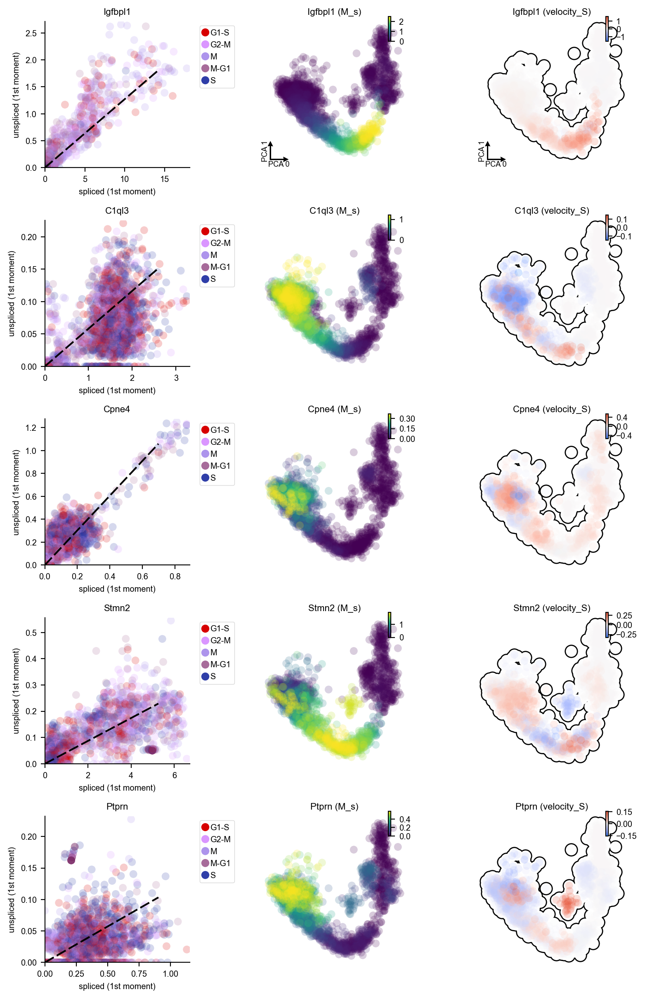

In [10]:
DentateGyrus_genes = ["Tnc", "Gfap", "Tac2", "Pdgfra", "Igfbpl1", 'Ptprn', "Sema3c", "Neurod6", "Stmn2", "Sema5a", "C1ql3", "Cpne4", "Cck"]

dyn.pl.phase_portraits(adata, genes=DentateGyrus_genes, ncols=3, figsize=(3, 3), basis='pca', show_quiver=False)

<Figure size 600x500 with 0 Axes>

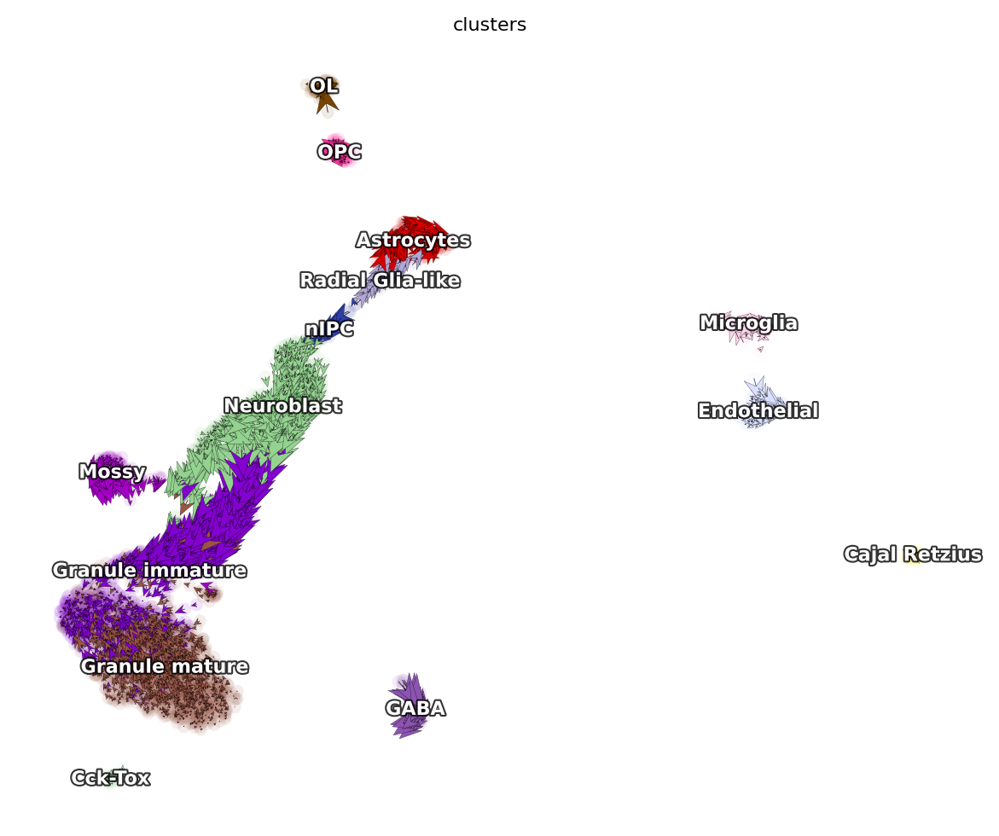

In [11]:
dyn.pl.cell_wise_vectors(adata, color=['clusters'], quiver_size=6, quiver_length=6, figsize=(6, 5), pointsize=0.1) # ['GRIA3', 'LINC00982', 'AFF2']



<Figure size 600x400 with 0 Axes>

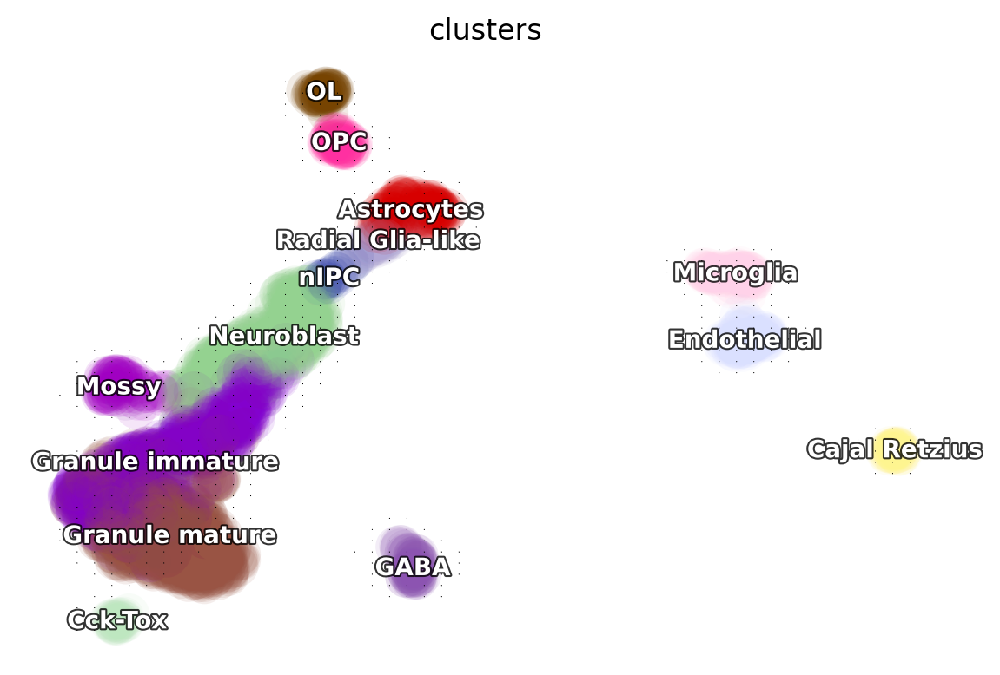

In [12]:
dyn.pl.grid_vectors(adata, color=['clusters'], method='gaussian')

<Figure size 600x400 with 0 Axes>

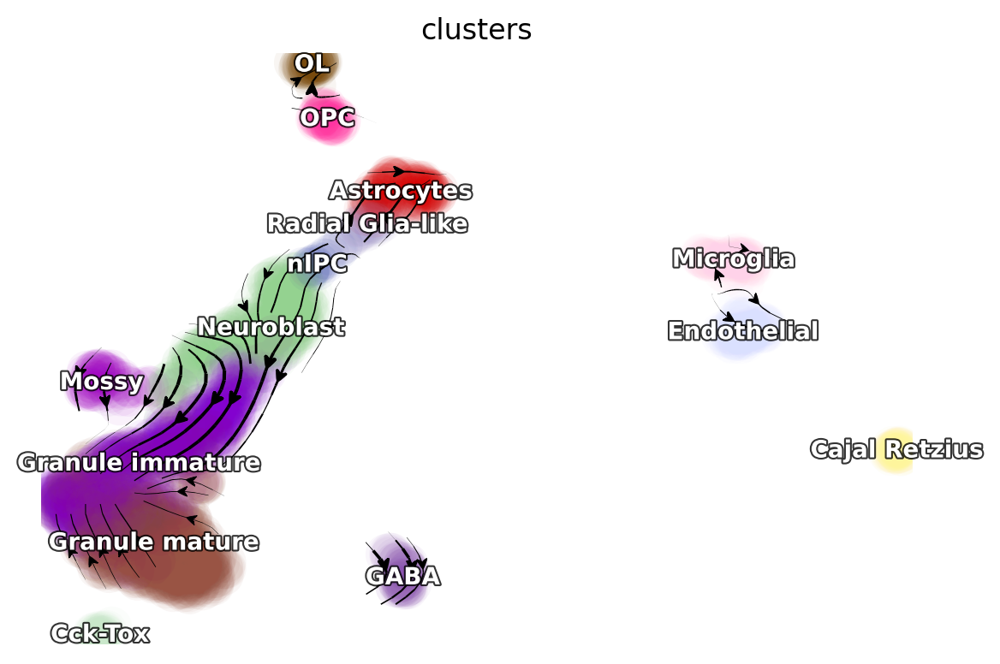

In [13]:
dyn.pl.streamline_plot(adata, color=['clusters'], basis='umap', density=1, background='white',s_kwargs_dict={"alpha": 0.05}) 

|-----> [projecting velocity vector to low dimensional embedding] in progress: 20.4778%

Using existing pearson_transition_matrix found in .obsp.


|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%
|-----> [projecting velocity vector to low dimensional embedding] finished [0.9663s]


<Figure size 600x400 with 0 Axes>

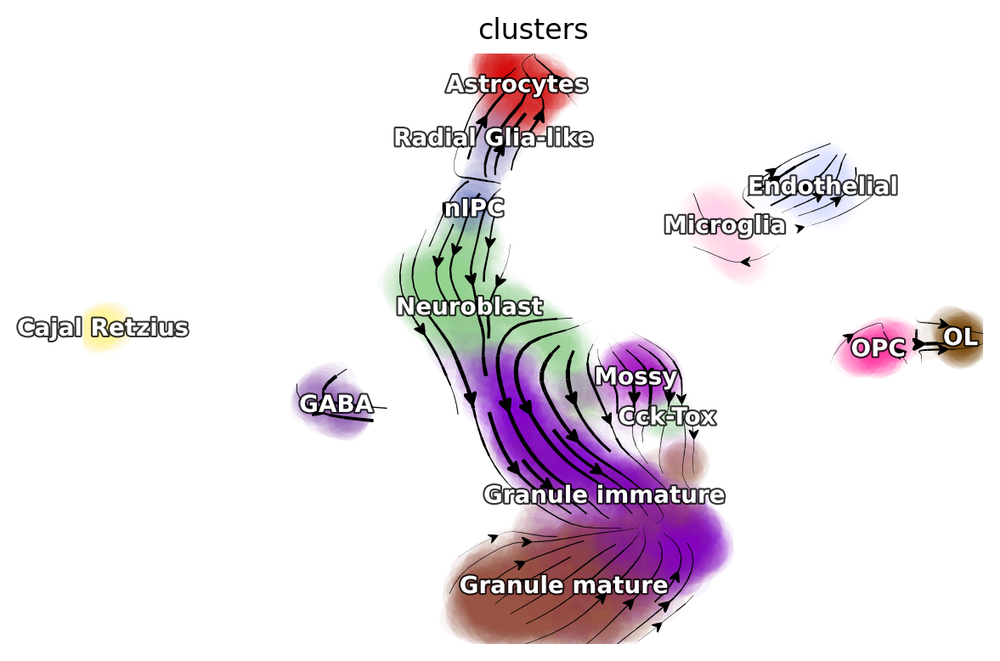

In [14]:
dyn.tl.cell_velocities(adata,  basis='umap_ori') 
dyn.pl.streamline_plot(adata, color=['clusters'], basis='umap_ori', density=1, background='white',s_kwargs_dict={"alpha": 0.05}) 

In [15]:
# you can set `verbose = 1/2/3` to obtain different levels of running information of vector field reconstruction 
dyn.vf.VectorField(adata, basis='umap_ori', dims=[0, 1], M=adata.n_obs)


|-----> vectorfield calculation begins...
|-----> Retrieve X and V based on basis: UMAP_ORI. 
        Vector field will be learned in the UMAP_ORI space.
|-----> Generating high dimensional grids and convert into a row matrix.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] in progress: 100.0000%
|-----> [SparseVFC] finished [23.8844s]
|-----> <insert> velocity_umap_ori_SparseVFC to obsm in AnnData Object.
|-----> <insert> X_umap_ori_SparseVFC to obsm in AnnData Object.
|-----> <insert> VecFld_umap_ori to uns in AnnData Object.
|-----> <insert> control_point_umap_ori to obs in AnnData Object.
|-----> <insert> inlier_prob_umap_ori to obs in AnnData Object.
|-----> <insert> obs_vf_angle_umap_ori to obs in AnnData Object.
|-----> [VectorField] in progress: 100.0000%
|-----> [VectorField] finished [24.1941s]


|-----> Vector field for umap is not constructed. Constructing it and mapping its topography now ...
|-----> vectorfield calculation begins...
|-----> Retrieve X and V based on basis: UMAP. 
        Vector field will be learned in the UMAP space.
|-----> Generating high dimensional grids and convert into a row matrix.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] in progress: 100.0000%
|-----> [SparseVFC] finished [3.8485s]
|-----> <insert> velocity_umap_SparseVFC to obsm in AnnData Object.
|-----> <insert> X_umap_SparseVFC to obsm in AnnData Object.
|-----> <insert> VecFld_umap to uns in AnnData Object.
|-----> Mapping topography...
|-----> <insert> control_point_umap to obs in AnnData Object.
|-----> <insert> inlier_prob_umap to obs in AnnData Object.
|-----> <insert> obs_vf_angle_umap to obs in AnnData Object.
|-----> [VectorField] in progress: 100.0000%
|---

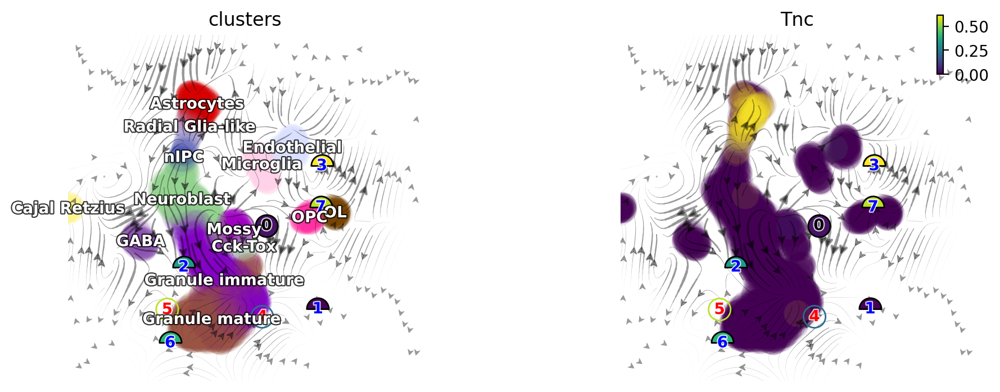

In [16]:
dyn.pl.topography(adata, color=['clusters', 'Tnc'], basis='umap_ori', ncols=2)

In [17]:
dyn.vf.VectorField(adata, basis='umap_ori', dims=[0, 1], pot_curl_div=True)


|-----> vectorfield calculation begins...
|-----> Retrieve X and V based on basis: UMAP_ORI. 
        Vector field will be learned in the UMAP_ORI space.
|-----> Generating high dimensional grids and convert into a row matrix.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] in progress: 100.0000%
|-----> [SparseVFC] finished [7.0363s]
|-----> <insert> velocity_umap_ori_SparseVFC to obsm in AnnData Object.
|-----> <insert> X_umap_ori_SparseVFC to obsm in AnnData Object.
|-----> <insert> VecFld_umap_ori to uns in AnnData Object.
|-----> Running ddhodge to estimate vector field based pseudotime in umap_ori basis...
|-----> [graphize_vecfld] in progress: 100.0000%
|-----> [graphize_vecfld] finished [107.2288s]
|-----> Computing curl...
Calculating 2-D curl: 100%|██████████| 2930/2930 [00:00<00:00, 10200.94it/s]
|-----> Computing divergence...
Calculating divergence: 1

In [18]:
dyn.ext.ddhodge(adata, basis='umap_ori')

In [19]:
adata

AnnData object with n_obs × n_vars = 2930 × 13913
    obs: 'clusters', 'age(days)', 'clusters_enlarged', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'control_point_umap_ori', 'inlier_prob_umap_ori', 'obs_vf_angle_umap_ori', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'umap_ori_ddhodge_div', 'umap_ori_ddhodge_potential', 'curl_umap_ori', 'divergence_umap_ori'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'score', 'log_m', 'log_cv', 'use_for_pca', 'frac', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters_colors', 'pp', 'velocyto_SVR', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'pca_fit', 'feature_sele

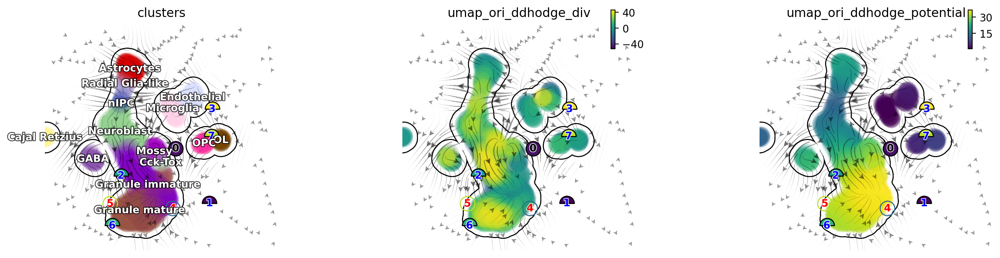

In [20]:
dyn.pl.topography(adata, color=['clusters', 'umap_ori_ddhodge_div', 'umap_ori_ddhodge_potential'], 
                  basis='umap_ori', ncols=3, frontier=True)


In [21]:
# emulate ggplot2 plotting styple with black background
dyn.configuration.set_figure_params('dynamo', background='black')  

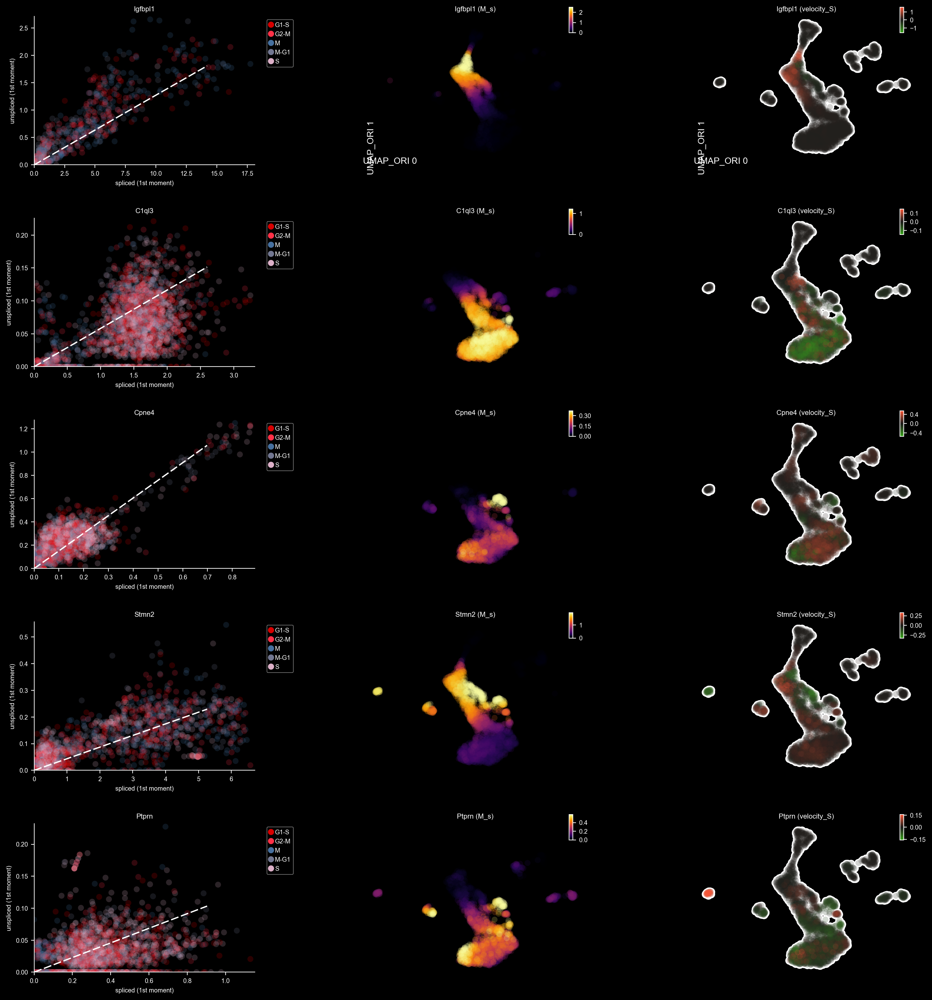

<Figure size 600x400 with 0 Axes>

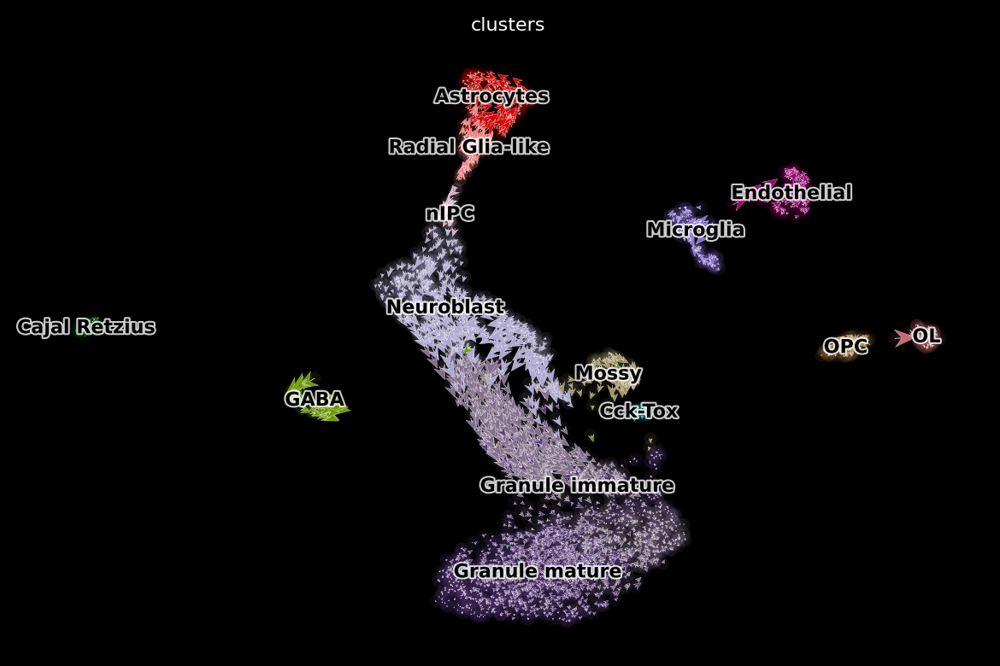

<Figure size 600x400 with 0 Axes>

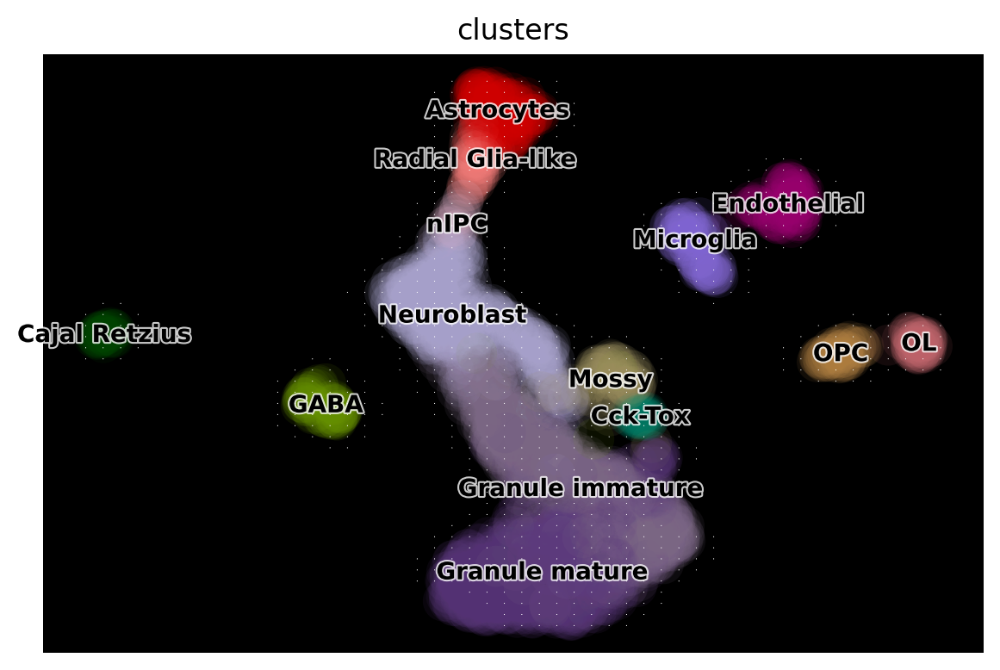

<Figure size 600x400 with 0 Axes>

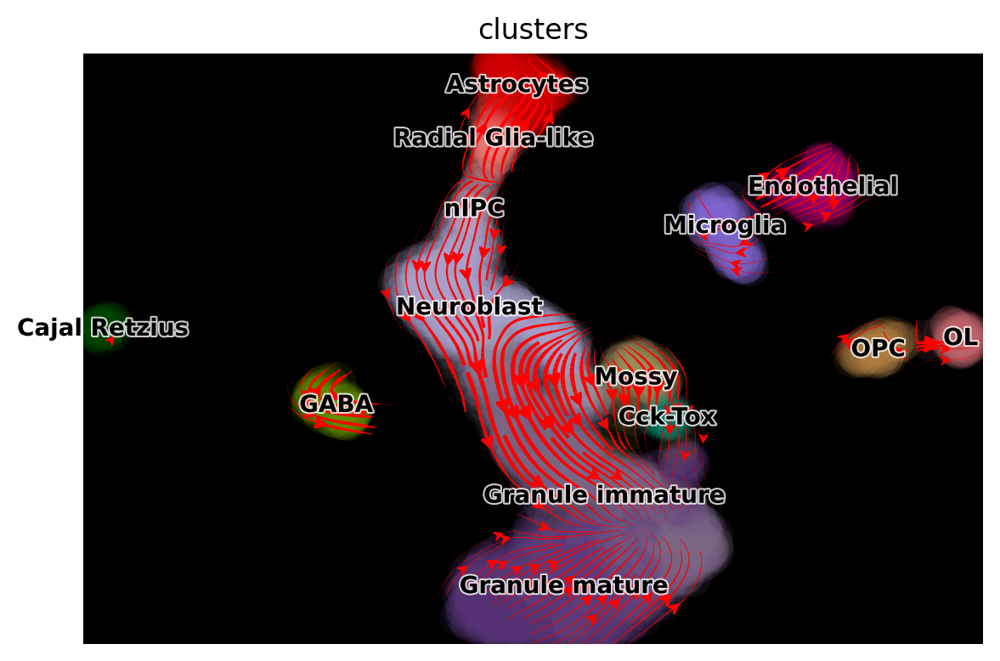

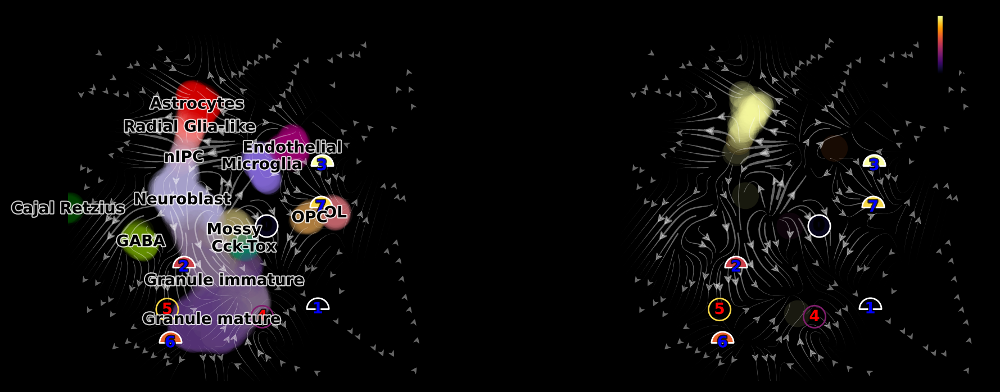

In [22]:

dyn.pl.phase_portraits(adata, genes=DentateGyrus_genes, ncols=3, figsize=(6, 4), basis='umap_ori', show_quiver=False)

dyn.pl.cell_wise_vectors(adata, color=['clusters'], basis='umap_ori', pointsize=0.1, quiver_size=4, quiver_length=4, background='black') # ['GRIA3', 'LINC00982', 'AFF2']

dyn.pl.grid_vectors(adata, color=['clusters'], basis='umap_ori', method='gaussian', background='black')

dyn.pl.streamline_plot(adata, color=['clusters'], basis='umap_ori', density=2, background='black') 

dyn.pl.topography(adata, color=['clusters', 'Tnc'], basis='umap_ori', ncols=2, background='black')


In [23]:
progenitor = adata.obs_names[adata.obs.clusters.isin(['nIPC', 'Neuroblast'])]
len(progenitor)

436

In [24]:
dyn.pd.fate(adata, basis='umap_ori', init_cells=progenitor, interpolation_num=100,  direction='forward',
   inverse_transform=False, average=False, cores=3)

AnnData object with n_obs × n_vars = 2930 × 13913
    obs: 'clusters', 'age(days)', 'clusters_enlarged', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'control_point_umap_ori', 'inlier_prob_umap_ori', 'obs_vf_angle_umap_ori', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'umap_ori_ddhodge_div', 'umap_ori_ddhodge_potential', 'curl_umap_ori', 'divergence_umap_ori'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'score', 'log_m', 'log_cv', 'use_for_pca', 'frac', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters_colors', 'pp', 'velocyto_SVR', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'pca_fit', 'feature_sele

In [25]:
%%capture
import matplotlib.pyplot as plt 

fig, ax = plt.subplots()
ax = dyn.pl.topography(adata, color='clusters', ax=ax, save_show_or_return='return', basis='umap_ori')

In [26]:
%%capture
instance = dyn.mv.StreamFuncAnim(adata=adata, ax=ax, basis='umap_ori', color='clusters')

|-----? the number of cell states with fate prediction is more than 50. You may want to lower the max number of cell states to draw via cell_states argument.


In [27]:
from matplotlib import animation
import numpy as np 

anim = animation.FuncAnimation(instance.fig, instance.update, init_func=instance.init_background,
                                frames=np.arange(100), interval=100, blit=True)
from IPython.core.display import display, HTML
HTML(anim.to_jshtml()) # embedding to jupyter notebook.

In [28]:
%%capture
fig, ax = plt.subplots()
ax = dyn.pl.topography(adata, color='clusters', basis='umap_ori', ax=ax, save_show_or_return='return')
dyn.mv.animate_fates(adata, color='clusters', basis='umap_ori', n_steps=100, fig=fig, ax=ax, 
                     save_show_or_return='save', logspace=True, max_time=None, save_kwargs={"filename": 'dentategyrus.gif'})


|-----? the number of cell states with fate prediction is more than 50. You may want to lower the max number of cell states to draw via cell_states argument.


In [29]:
dyn.pl.streamline_plot(adata, color=['Ptprn'], basis='umap_ori', show_legend='on data',  background='white',
                        show_arrowed_spines=False, save_show_or_return='save',
                        pointsize=0.4, ncols=1, alpha = 0.7, 
                       save_kwargs={'prefix': 'dentategyrus_streamline', 'ext': 'png',
                                     "bbox_inches": None}, 
                        figsize=(3, 3))

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/dentategyrus_streamline_dyn_savefig.png...
Done


<Figure size 300x300 with 0 Axes>

In [30]:
dyn.pl.phase_portraits(adata, genes=['Ptprn'], basis='umap_ori',
                       show_quiver=True,
                       background='white',
                        show_arrowed_spines=False, save_show_or_return='save',
                        pointsize=0.4, alpha = 0.7, quiver_length=10, quiver_size=6, 
                       save_kwargs={'prefix': 'dentategyrus_phase_portrait', 'ext': 'png',
                                     "bbox_inches": None}, 
                        figsize=(6, 4))

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/dentategyrus_phase_portrait_dyn_savefig.png...
Done


In [31]:
dyn.pl.topography(adata, color=['Ptprn'], basis='umap_ori', show_legend='on data',  background='white',
                        show_arrowed_spines=False, save_show_or_return='save',
                        pointsize=0.4, ncols=1, alpha = 0.7, 
                       save_kwargs={'prefix': 'dentategyrus_topography', 'ext': 'png',
                                     "bbox_inches": None}, 
                        figsize=(3, 3))

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/dentategyrus_topography_dyn_savefig.png...
Done


<Figure size 300x300 with 0 Axes>

In [32]:
dyn.tl.cell_velocities(adata, basis='pca')
dyn.vf.VectorField(adata, basis='pca', M=adata.n_obs, pot_curl_div=True)


|-----> [projecting velocity vector to low dimensional embedding] in progress: 2.0478%

Using existing pearson_transition_matrix found in .obsp.


|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%
|-----> [projecting velocity vector to low dimensional embedding] finished [1.4486s]
|-----> vectorfield calculation begins...
|-----> Retrieve X and V based on basis: PCA. 
        Vector field will be learned in the PCA space.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] in progress: 100.0000%
|-----> [SparseVFC] finished [26.1559s]
|-----> <insert> velocity_pca_SparseVFC to obsm in AnnData Object.
|-----> <insert> X_pca_SparseVFC to obsm in AnnData Object.
|-----> <insert> VecFld_pca to uns in AnnData Object.
|-----> Running ddhodge to estimate vector field based pseudotime in pca basis...
|-----> [graphize_vecfld] in progress: 100.0000%
|-----> [graphize_vecfld] finished [389.9401s]
|-----> Computing divergence...
Calculating divergence: 100%|██████████| 2930/2930 [00:0

In [33]:
adata

AnnData object with n_obs × n_vars = 2930 × 13913
    obs: 'clusters', 'age(days)', 'clusters_enlarged', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'control_point_umap_ori', 'inlier_prob_umap_ori', 'obs_vf_angle_umap_ori', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'umap_ori_ddhodge_div', 'umap_ori_ddhodge_potential', 'curl_umap_ori', 'divergence_umap_ori', 'pca_ddhodge_div', 'pca_ddhodge_potential', 'divergence_pca', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'score', 'log_m', 'log_cv', 'use_for_pca', 'frac', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'


In [34]:
dyn.tl.cell_velocities(adata, basis='pca')
dyn.vf.VectorField(adata, basis='pca')
dyn.vf.speed(adata, basis='pca')
dyn.vf.divergence(adata, basis='pca')
dyn.vf.acceleration(adata, basis='pca')
dyn.vf.curl(adata, basis='umap_ori')

|-----> [projecting velocity vector to low dimensional embedding] in progress: 15.3584%

Using existing pearson_transition_matrix found in .obsp.


|-----> [projecting velocity vector to low dimensional embedding] in progress: 100.0000%
|-----> [projecting velocity vector to low dimensional embedding] finished [1.2979s]
|-----> vectorfield calculation begins...
|-----> Retrieve X and V based on basis: PCA. 
        Vector field will be learned in the PCA space.
|-----> Learning vector field with method: sparsevfc.
|-----> [SparseVFC] begins...
|-----> Sampling control points based on data velocity magnitude...
|-----> [SparseVFC] in progress: 100.0000%
|-----> [SparseVFC] finished [1.0630s]
|-----> <insert> velocity_pca_SparseVFC to obsm in AnnData Object.
|-----> <insert> X_pca_SparseVFC to obsm in AnnData Object.
|-----> <insert> VecFld_pca to uns in AnnData Object.
|-----> <insert> control_point_pca to obs in AnnData Object.
|-----> <insert> inlier_prob_pca to obs in AnnData Object.
|-----> <insert> obs_vf_angle_pca to obs in AnnData Object.
|-----> [VectorField] in progress: 100.0000%
|-----> [VectorField] finished [1.1959s]
C

In [35]:
adata

AnnData object with n_obs × n_vars = 2930 × 13913
    obs: 'clusters', 'age(days)', 'clusters_enlarged', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase', 'control_point_umap_ori', 'inlier_prob_umap_ori', 'obs_vf_angle_umap_ori', 'control_point_umap', 'inlier_prob_umap', 'obs_vf_angle_umap', 'umap_ori_ddhodge_div', 'umap_ori_ddhodge_potential', 'curl_umap_ori', 'divergence_umap_ori', 'pca_ddhodge_div', 'pca_ddhodge_potential', 'divergence_pca', 'control_point_pca', 'inlier_prob_pca', 'obs_vf_angle_pca', 'speed_pca', 'acceleration_pca'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'score', 'log_m', 'log_cv', 'use_for_pca', 'frac', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for

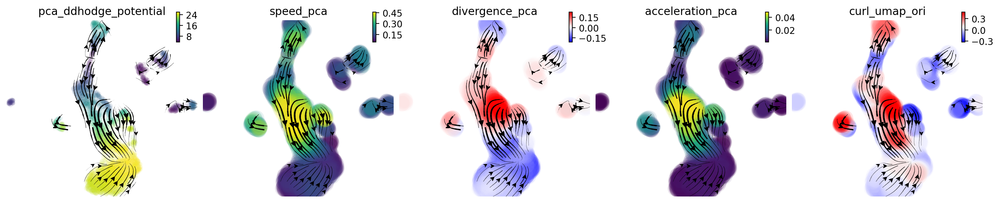

In [36]:
import matplotlib.pyplot as plt
fig1, f1_axes = plt.subplots(ncols=5, nrows=1, constrained_layout=True, figsize=(15, 3))
f1_axes
f1_axes[0] = dyn.pl.streamline_plot(adata, basis='umap_ori', color='pca_ddhodge_potential', pointsize=0.1, alpha = 0.7, ax=f1_axes[0], quiver_length=6, 
                                    quiver_size=6, save_show_or_return='return', show_arrowed_spines=False)
f1_axes[1] = dyn.pl.streamline_plot(adata, basis='umap_ori', color='speed_pca', ax=f1_axes[1], quiver_length=12, quiver_size=12, save_show_or_return='return', 
                                    show_arrowed_spines=False)
f1_axes[2] = dyn.pl.streamline_plot(adata, basis='umap_ori', color='divergence_pca', ax=f1_axes[2], save_show_or_return='return',
                                   show_arrowed_spines=False, cmap='bwr', sym_c=True)
f1_axes[3] = dyn.pl.streamline_plot(adata, basis='umap_ori', color='acceleration_pca', ax=f1_axes[3], save_show_or_return='return', 
                                    show_arrowed_spines=False)
f1_axes[4] = dyn.pl.streamline_plot(adata, basis='umap_ori', color='curl_umap_ori', ax=f1_axes[4], save_show_or_return='return', 
                                    show_arrowed_spines=False, cmap='bwr', sym_c=True)
plt.savefig(dpi=300, fname='./dentategyrus_vector_calculus.png')

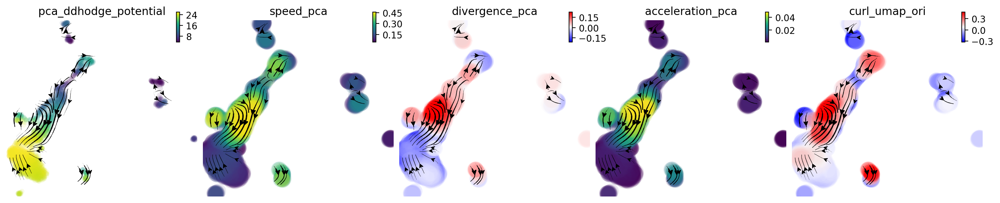

In [38]:
import matplotlib.pyplot as plt
fig1, f1_axes = plt.subplots(ncols=5, nrows=1, constrained_layout=True, figsize=(15, 3))
f1_axes
f1_axes[0] = dyn.pl.streamline_plot(adata, basis='umap', color='pca_ddhodge_potential', pointsize=0.1, alpha = 0.7, ax=f1_axes[0], quiver_length=6, 
                                    quiver_size=6, save_show_or_return='return', show_arrowed_spines=False)
f1_axes[1] = dyn.pl.streamline_plot(adata, basis='umap', color='speed_pca', ax=f1_axes[1], quiver_length=12, quiver_size=12, save_show_or_return='return', 
                                    show_arrowed_spines=False)
f1_axes[2] = dyn.pl.streamline_plot(adata, basis='umap', color='divergence_pca', ax=f1_axes[2], save_show_or_return='return',
                                   show_arrowed_spines=False, cmap='bwr', sym_c=True)
f1_axes[3] = dyn.pl.streamline_plot(adata, basis='umap', color='acceleration_pca', ax=f1_axes[3], save_show_or_return='return', 
                                    show_arrowed_spines=False)
f1_axes[4] = dyn.pl.streamline_plot(adata, basis='umap', color='curl_umap_ori', ax=f1_axes[4], save_show_or_return='return', 
                                    show_arrowed_spines=False, cmap='bwr', sym_c=True)
plt.savefig(dpi=300, fname='./dentategyrus_vector_calculus.png')

In [39]:
example_genes = ['Ptprn']
import numpy as np 

dyn.pl.scatters(adata, x=np.repeat('pca_ddhodge_potential', 1),
                     y=example_genes, layer='X_spliced', color='pca_ddhodge_potential', 
                     background='white', figsize=(3, 3), save_show_or_return='save',
                     pointsize=0.4, ncols=1, alpha = 0.7, 
                     save_kwargs={'prefix': 'dentategyrus_potential', 'ext': 'png', "bbox_inches": None})

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/dentategyrus_potential_dyn_savefig.png...
Done


<Figure size 300x300 with 0 Axes>

|-----> Downloading data to ./data/dentategyrus_scv.h5ad
|-----> apply Monocole recipe to adata...
|-----> <insert> pp to uns in AnnData Object.
|-----------> <insert> has_splicing to uns['pp'] in AnnData Object.
|-----------> <insert> has_labling to uns['pp'] in AnnData Object.
|-----------> <insert> splicing_labeling to uns['pp'] in AnnData Object.
|-----------> <insert> has_protein to uns['pp'] in AnnData Object.
|-----> ensure all cell and variable names unique.
|-----> ensure all data in different layers in csr sparse matrix format.
|-----> ensure all labeling data properly collapased
|-----------> <insert> tkey to uns['pp'] in AnnData Object.
|-----------> <insert> experiment_type to uns['pp'] in AnnData Object.
|-----> filtering cells...
|-----> filtering genes...
|-----> calculating size factor...
|-----> selecting genes...
|-----> <insert> frac to var in AnnData Object.
|-----> size factor normalizing the data, followed by log1p transformation.
|-----> applying PCA ...
|----->

<Figure size 600x400 with 0 Axes>

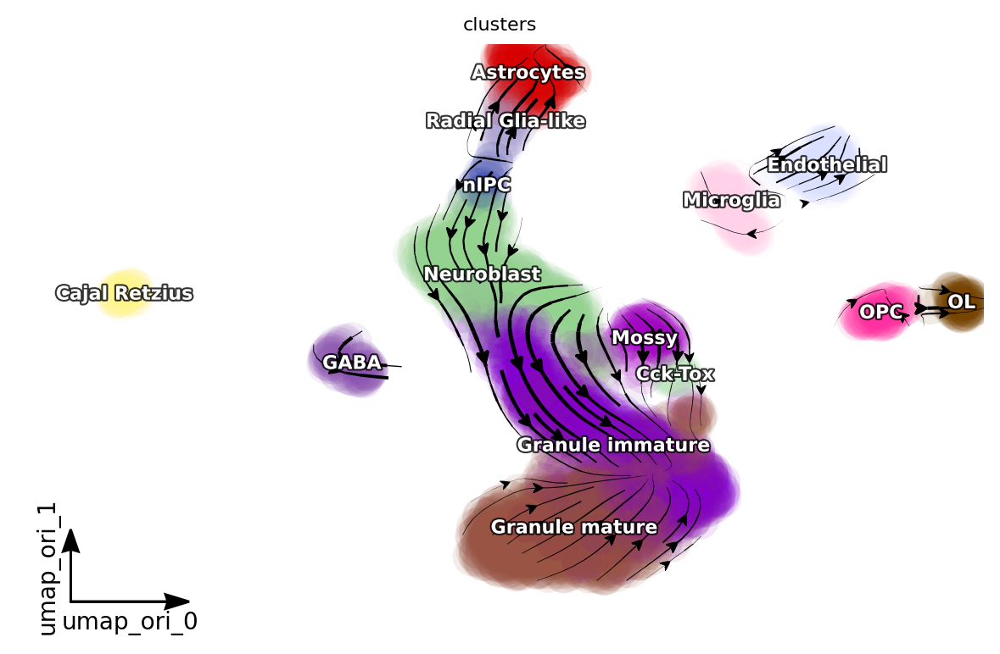

In [51]:
# # run dynamo stochastic 

# run dynamo to get RNA velocity 

dyn.configuration.set_figure_params('dynamo', background='white')

adata = dyn.sample_data.DentateGyrus_scvelo()
adata.obsm['X_umap_ori'] = adata.obsm['X_umap'].copy()

dyn.pp.recipe_monocle(adata, n_top_genes=2000, fg_kwargs={'shared_count': 30}, num_dim=30)

dyn.tl.dynamics(adata, model='stochastic')

dyn.tl.reduceDimension(adata, n_pca_components=30)

dyn.tl.cell_velocities(adata, method='pearson', other_kernels_dict={'transform': 'sqrt'}, enforce=True, basis='umap_ori')
dyn.pl.streamline_plot(adata, color=['clusters'], basis='umap_ori', show_legend='on data', show_arrowed_spines=True)


|-----> Downloading data to ./data/dentategyrus_scv.h5ad
|-----> apply Monocole recipe to adata...
|-----> <insert> pp to uns in AnnData Object.
|-----------> <insert> has_splicing to uns['pp'] in AnnData Object.
|-----------> <insert> has_labling to uns['pp'] in AnnData Object.
|-----------> <insert> splicing_labeling to uns['pp'] in AnnData Object.
|-----------> <insert> has_protein to uns['pp'] in AnnData Object.
|-----> ensure all cell and variable names unique.
|-----> ensure all data in different layers in csr sparse matrix format.
|-----> ensure all labeling data properly collapased
|-----------> <insert> tkey to uns['pp'] in AnnData Object.
|-----------> <insert> experiment_type to uns['pp'] in AnnData Object.
|-----> filtering cells...
|-----> filtering genes...
|-----> calculating size factor...
|-----> selecting genes...
|-----> <insert> frac to var in AnnData Object.
|-----> size factor normalizing the data, followed by log1p transformation.
|-----> applying PCA ...
|----->

<Figure size 600x400 with 0 Axes>

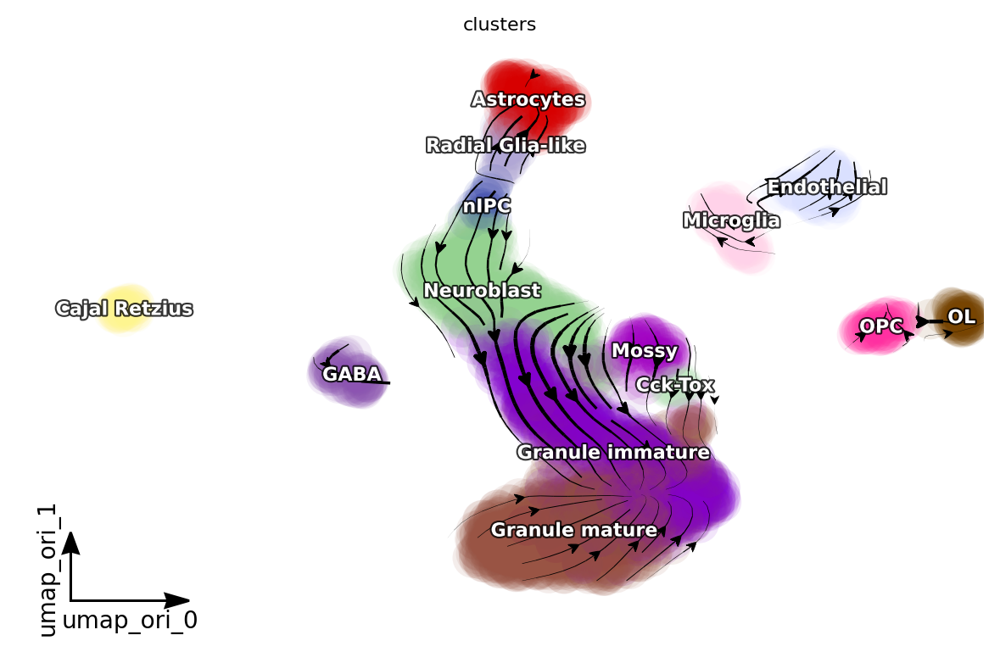

In [52]:
# # run dynamo determinstic 

# run dynamo to get RNA velocity 

dyn.configuration.set_figure_params('dynamo', background='white')

adata_det = dyn.sample_data.DentateGyrus_scvelo()
adata_det.obsm['X_umap_ori'] = adata_det.obsm['X_umap'].copy()

dyn.pp.recipe_monocle(adata_det, n_top_genes=2000, fg_kwargs={'shared_count': 30}, num_dim=30)

dyn.tl.dynamics(adata_det, model='deterministic')

dyn.tl.reduceDimension(adata_det, n_pca_components=30)


dyn.tl.cell_velocities(adata_det, method='pearson', other_kernels_dict={'transform': 'sqrt'}, enforce=True, basis='umap_ori')
dyn.pl.streamline_plot(adata_det, color=['clusters'], basis='umap_ori', show_legend='on data', show_arrowed_spines=True)


In [53]:
adata_det

AnnData object with n_obs × n_vars = 2930 × 13913
    obs: 'clusters', 'age(days)', 'clusters_enlarged', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'score', 'log_m', 'log_cv', 'use_for_pca', 'frac', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters_colors', 'pp', 'velocyto_SVR', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'pca_fit', 'feature_selection', 'cell_phase_genes', 'dynamics', 'neighbors', 'grid_velocity_umap_ori'
    obsm: 'X_umap', 'X_umap_ori', 'X_pca', 'X', 'cell_cycle_scores', 'velocity_umap_ori'
    layers: 'ambiguous', 'spliced', 'unspliced', 'X_spliced', 'X_

|-----> Downloading data to ./data/dentategyrus_scv.h5ad
|-----> apply Monocole recipe to adata...
|-----> <insert> pp to uns in AnnData Object.
|-----------> <insert> has_splicing to uns['pp'] in AnnData Object.
|-----------> <insert> has_labling to uns['pp'] in AnnData Object.
|-----------> <insert> splicing_labeling to uns['pp'] in AnnData Object.
|-----------> <insert> has_protein to uns['pp'] in AnnData Object.
|-----> ensure all cell and variable names unique.
|-----> ensure all data in different layers in csr sparse matrix format.
|-----> ensure all labeling data properly collapased
|-----------> <insert> tkey to uns['pp'] in AnnData Object.
|-----------> <insert> experiment_type to uns['pp'] in AnnData Object.
|-----> filtering cells...
|-----> filtering genes...
|-----> calculating size factor...
|-----> selecting genes...
|-----> <insert> frac to var in AnnData Object.
|-----> size factor normalizing the data, followed by log1p transformation.
|-----> applying PCA ...
|----->

<Figure size 600x400 with 0 Axes>

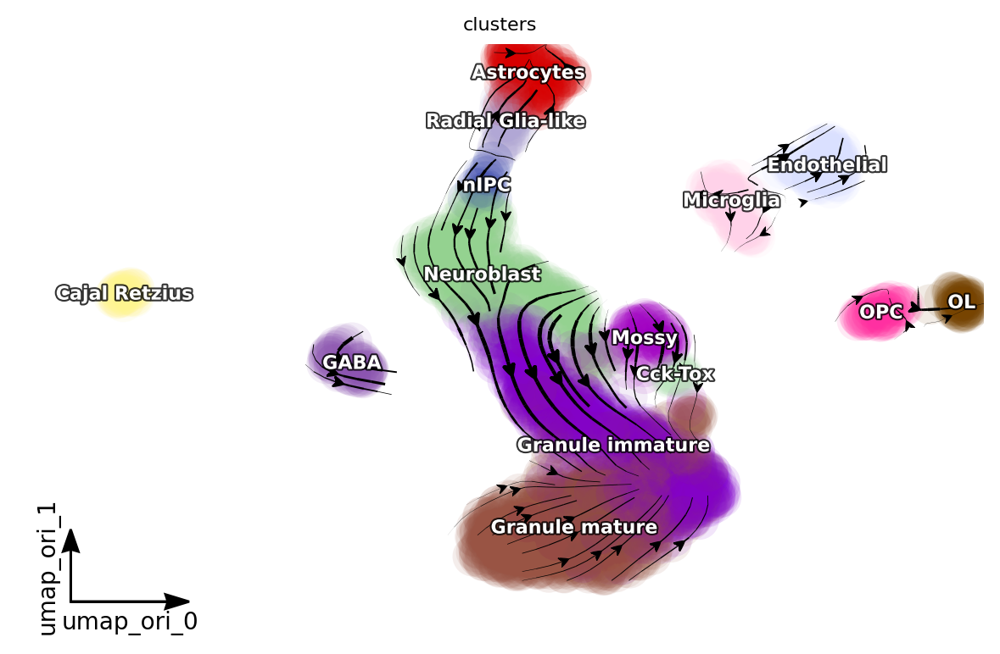

In [54]:
# run dynamo nb 


# run dynamo to get RNA velocity 

dyn.configuration.set_figure_params('dynamo', background='white')

adata_nb = dyn.sample_data.DentateGyrus_scvelo()
adata_nb.obsm['X_umap_ori'] = adata_nb.obsm['X_umap'].copy()

dyn.pp.recipe_monocle(adata_nb, n_top_genes=2000, fg_kwargs={'shared_count': 30}, num_dim=30)

dyn.tl.dynamics(adata_nb, est_method='negbin')

dyn.tl.reduceDimension(adata_nb, n_pca_components=30)

dyn.tl.cell_velocities(adata_nb, method='pearson', other_kernels_dict={'transform': 'sqrt'}, basis='umap_ori')
dyn.pl.streamline_plot(adata_nb, color=['clusters'], basis='umap_ori', show_legend='on data', show_arrowed_spines=True)


In [55]:
adata.var.use_for_transition.sum(), adata_det.var.use_for_transition.sum(), adata_nb.var.use_for_transition.sum()

(479, 504, 606)

In [56]:
dyn.cleanup(adata)
dyn.cleanup(adata_det)
dyn.cleanup(adata_nb)

AnnData object with n_obs × n_vars = 2930 × 13913
    obs: 'clusters', 'age(days)', 'clusters_enlarged', 'nGenes', 'nCounts', 'pMito', 'use_for_pca', 'spliced_Size_Factor', 'initial_spliced_cell_size', 'Size_Factor', 'initial_cell_size', 'unspliced_Size_Factor', 'initial_unspliced_cell_size', 'ntr', 'cell_cycle_phase'
    var: 'nCells', 'nCounts', 'pass_basic_filter', 'score', 'log_m', 'log_cv', 'use_for_pca', 'frac', 'ntr', 'beta', 'gamma', 'half_life', 'alpha_b', 'alpha_r2', 'gamma_b', 'gamma_r2', 'gamma_logLL', 'delta_b', 'delta_r2', 'bs', 'bf', 'uu0', 'ul0', 'su0', 'sl0', 'U0', 'S0', 'total0', 'use_for_dynamics', 'use_for_transition'
    uns: 'clusters_colors', 'pp', 'velocyto_SVR', 'PCs', 'explained_variance_ratio_', 'pca_mean', 'pca_fit', 'feature_selection', 'cell_phase_genes', 'dynamics', 'neighbors', 'grid_velocity_umap_ori'
    obsm: 'X_umap', 'X_umap_ori', 'X_pca', 'X', 'cell_cycle_scores', 'velocity_umap_ori'
    layers: 'ambiguous', 'spliced', 'unspliced', 'X_spliced', 'X_

In [58]:
adata.write_h5ad('./data/DentateGyrus_scvelo_dynamo_stochastic.h5ad')
adata_det.write_h5ad('./data/DentateGyrus_scvelo_dynamo_det.h5ad')
adata_nb.write_h5ad('./data/DentateGyrus_scvelo_dynamo_nb.h5ad')

In [63]:
dyn.pl.streamline_plot(adata, color=['clusters'], basis='umap_ori', show_legend='on data',  background='white',
                        show_arrowed_spines=False, save_show_or_return='save',
                        pointsize=0.4, ncols=1, alpha = 0.7, 
                       save_kwargs={'prefix': 'dentate_gyrus_stochastic', 'ext': 'svg',
                                     "bbox_inches": None}, 
                        figsize=(4, 3))

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/dentate_gyrus_stochastic_dyn_savefig.svg...
Done


<Figure size 400x300 with 0 Axes>

In [61]:
dyn.pl.streamline_plot(adata_det, color=['clusters'], basis='umap_ori', show_legend='on data',  background='white',
                        show_arrowed_spines=False, save_show_or_return='save',
                        pointsize=0.4, ncols=1, alpha = 0.7, 
                       save_kwargs={'prefix': 'dentate_gyrus_det', 'ext': 'svg',
                                     "bbox_inches": None}, 
                        figsize=(4, 3))

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/dentate_gyrus_det_dyn_savefig.svg...
Done


<Figure size 400x300 with 0 Axes>

In [62]:
dyn.pl.streamline_plot(adata_nb, color=['clusters'], basis='umap_ori', show_legend='on data',  background='white',
                        show_arrowed_spines=False, save_show_or_return='save',
                        pointsize=0.4, ncols=1, alpha = 0.7, 
                       save_kwargs={'prefix': 'dentate_gyrus_nb', 'ext': 'svg',
                                     "bbox_inches": None}, 
                        figsize=(4, 3))

Saving figure to /lab/solexa_weissman/xqiu/proj/Aristotle/dynamo-tutorials/dentate_gyrus_nb_dyn_savefig.svg...
Done


<Figure size 400x300 with 0 Axes>